In [1]:
print("Importing libraries")
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time
print("Done importing libraries")

Importing libraries


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice\nMin: {original_slice.min().round(2)}, Max: {original_slice.max().round(2)}')
        plt.colorbar()
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray', vmin=-0.5, vmax=0.5)  # Specify vmin and vmax here , vmin=-0.5, vmax=0.5
        plt.title(f'Reconstructed {title} Slice\nMin: {reconstruction_slice.min().round(2)}, Max: {reconstruction_slice.max().round(2)}')
        plt.colorbar()
        plt.show()
    
    def plot_histograms(self, original_slice, reconstruction_slice, title):
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))

        # Plot histogram for original slice
        axes[0].hist(original_slice.flatten(), bins=50, color='b', alpha=0.7)
        axes[0].set_title(f'Original {title} Slice Histogram')
        axes[0].set_xlabel('Pixel Value')
        axes[0].set_ylabel('Frequency')

        # Plot histogram for reconstruction slice
        axes[1].hist(reconstruction_slice.flatten(), bins=50, color='r', alpha=0.7)
        axes[1].set_title(f'Reconstructed {title} Slice Histogram')
        axes[1].set_xlabel('Pixel Value')
        axes[1].set_ylabel('Frequency')

        plt.tight_layout()
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 256), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function =  nn.MSELoss()
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)

   
    def training_step(self, batch, batch_idx):
        x, y = batch
        x = x.unsqueeze(1)  # Add channel dimension
        y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % 300 == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Train Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Train Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Train Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        x = x.unsqueeze(1)  # Add channel dimension
        y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % 300 == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Val Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Val Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Val Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-3)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars('AE SSIM Job 10 Loss', {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='AE_SSIM{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc, transform=transform, num_workers=0)
val_dataset   = CacheDataset(val_dataset_uc,   transform=transform, num_workers=0)

train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True,  num_workers=4)
val_dataloader   = DataLoader(val_dataset,   batch_size=1, shuffle=False, num_workers=4)

trainer = pl.Trainer(
    max_epochs=1500,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)

Loading dataset:   0%|          | 0/18 [00:00<?, ?it/s]

Loading dataset:   6%|▌         | 1/18 [00:03<01:04,  3.78s/it]

Loading dataset:  11%|█         | 2/18 [00:10<01:23,  5.22s/it]

Loading dataset:  17%|█▋        | 3/18 [00:13<01:08,  4.55s/it]

Loading dataset:  22%|██▏       | 4/18 [00:17<00:59,  4.27s/it]

Loading dataset:  28%|██▊       | 5/18 [00:22<00:57,  4.45s/it]

Loading dataset:  33%|███▎      | 6/18 [00:27<00:54,  4.55s/it]

Loading dataset:  39%|███▉      | 7/18 [00:30<00:47,  4.28s/it]

Loading dataset:  44%|████▍     | 8/18 [00:36<00:45,  4.57s/it]

Loading dataset:  50%|█████     | 9/18 [00:41<00:42,  4.70s/it]

Loading dataset:  56%|█████▌    | 10/18 [00:44<00:35,  4.39s/it]

Loading dataset:  61%|██████    | 11/18 [00:48<00:28,  4.10s/it]

Loading dataset:  67%|██████▋   | 12/18 [00:55<00:31,  5.17s/it]

Loading dataset:  72%|███████▏  | 13/18 [00:59<00:23,  4.76s/it]

Loading dataset:  78%|███████▊  | 14/18 [01:03<00:18,  4.61s/it]

Loading dataset:  83%|████████▎ | 15/18 [01:09<00:14,  4.98s/it]

Loading dataset:  89%|████████▉ | 16/18 [01:13<00:09,  4.74s/it]

Loading dataset:  94%|█████████▍| 17/18 [01:18<00:04,  4.57s/it]

Loading dataset: 100%|██████████| 18/18 [01:21<00:00,  4.20s/it]

Loading dataset: 100%|██████████| 18/18 [01:21<00:00,  4.52s/it]

Loading dataset:   0%|          | 0/8 [00:00<?, ?it/s]

Loading dataset:  12%|█▎        | 1/8 [00:03<00:25,  3.63s/it]

Loading dataset:  25%|██▌       | 2/8 [00:11<00:36,  6.00s/it]

Loading dataset:  38%|███▊      | 3/8 [00:14<00:24,  4.93s/it]

Loading dataset:  50%|█████     | 4/8 [00:21<00:21,  5.41s/it]

Loading dataset:  62%|██████▎   | 5/8 [00:24<00:14,  4.74s/it]

Loading dataset:  75%|███████▌  | 6/8 [00:29<00:09,  4.70s/it]

Loading dataset:  88%|████████▊ | 7/8 [00:33<00:04,  4.67s/it]

Loading dataset: 100%|██████████| 8/8 [00:38<00:00,  4.80s/it]

Loading dataset: 100%|██████████| 8/8 [00:38<00:00,  4.87s/it]

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/callbacks/model_checkpoint.py:653: Checkpoint directory /old_Users/tgafrick/RA4/jobs/job10/Models exists and is not empty.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 6.5 M 
1 | loss_function | MSELoss     | 0     
----------------------------------------------
6.5 M     Trainable params
0         Non-trainable params
6.5 M     Total params
25.892    Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

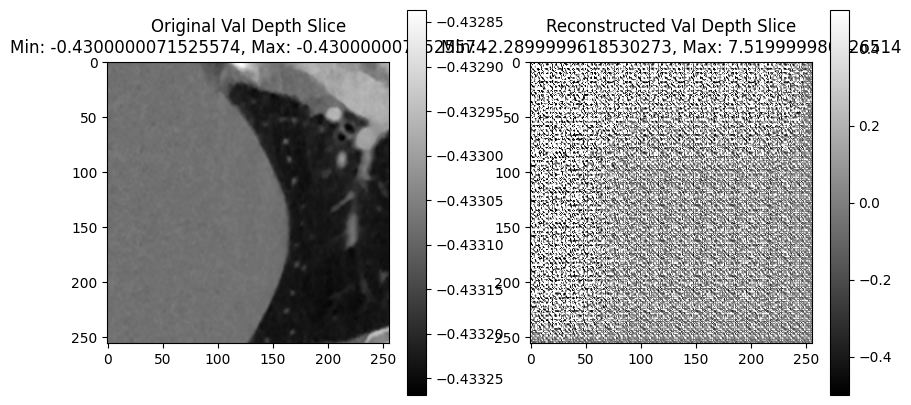

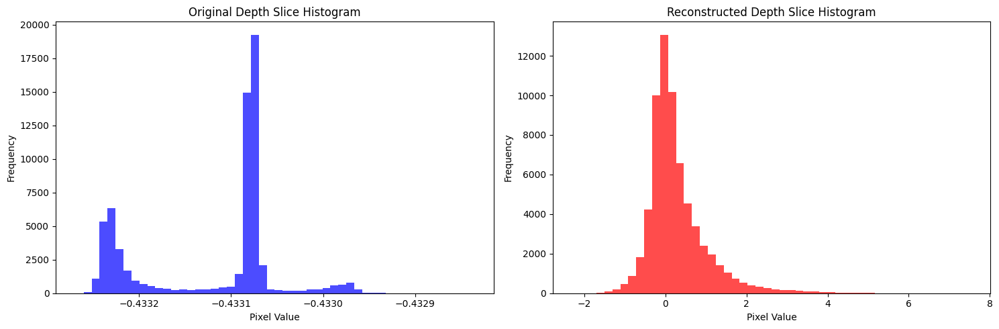

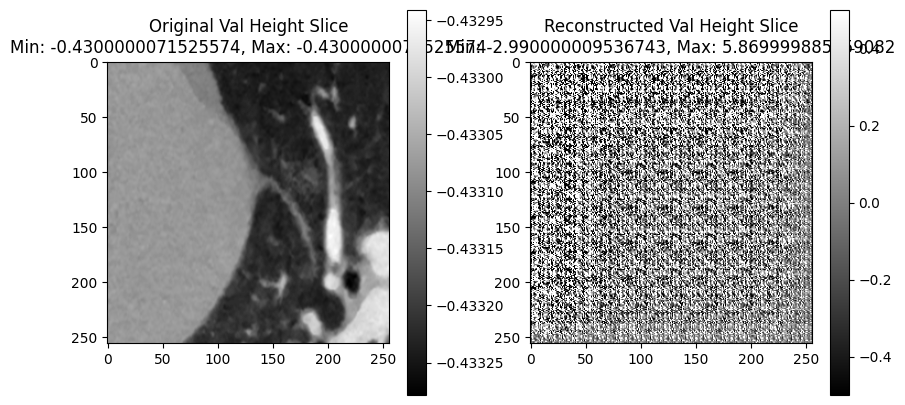

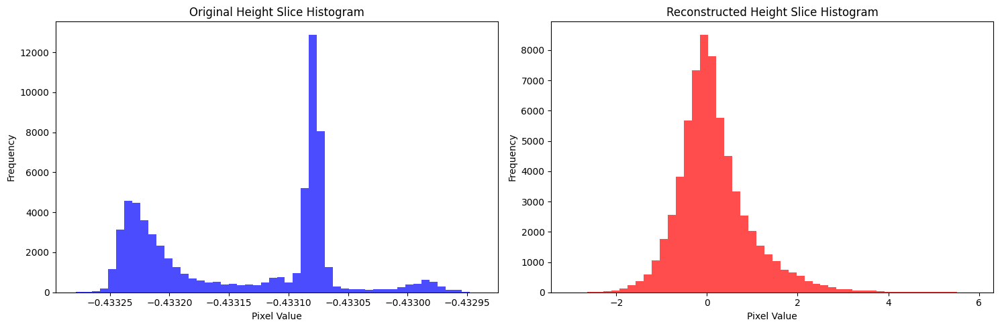

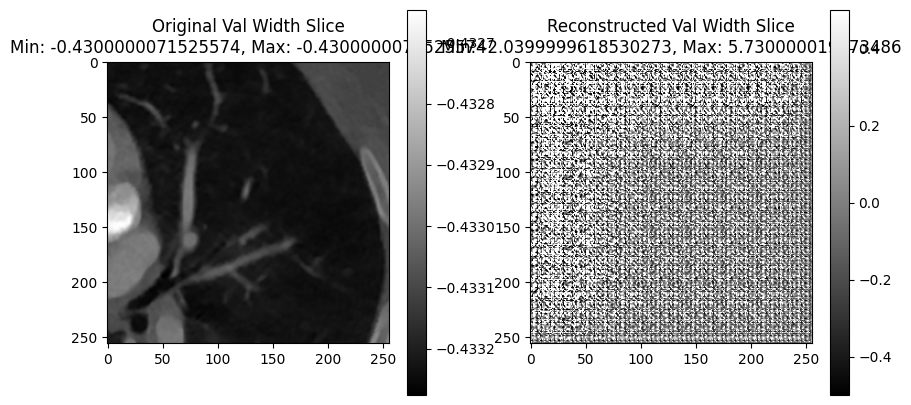

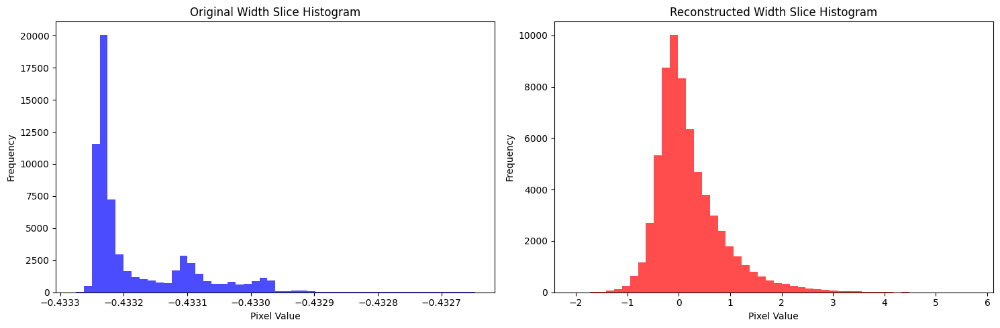

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (18) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

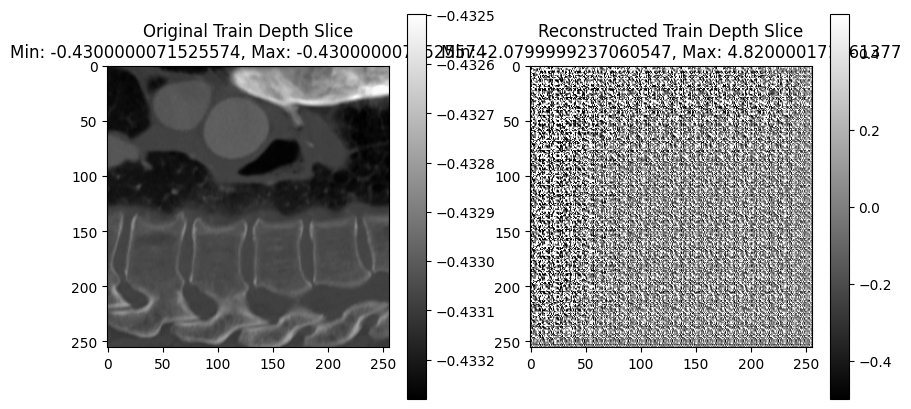

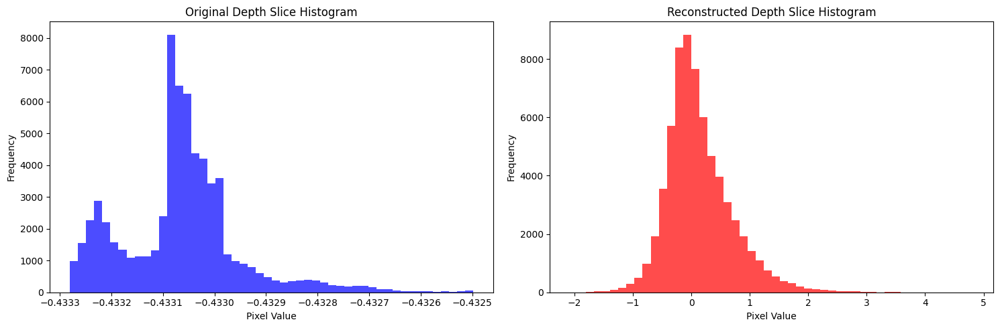

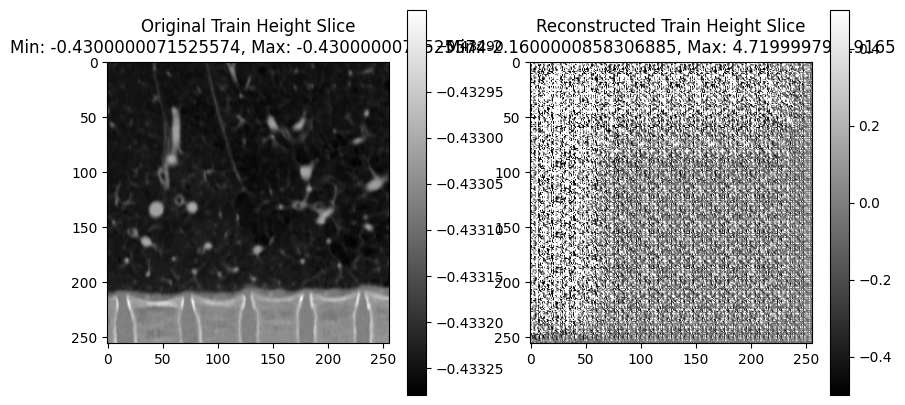

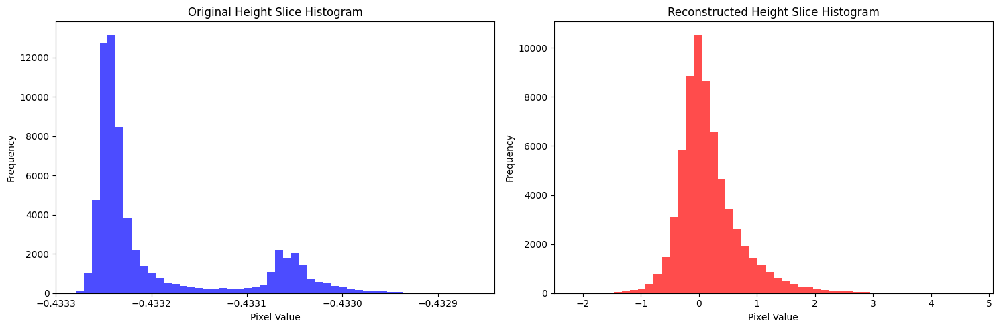

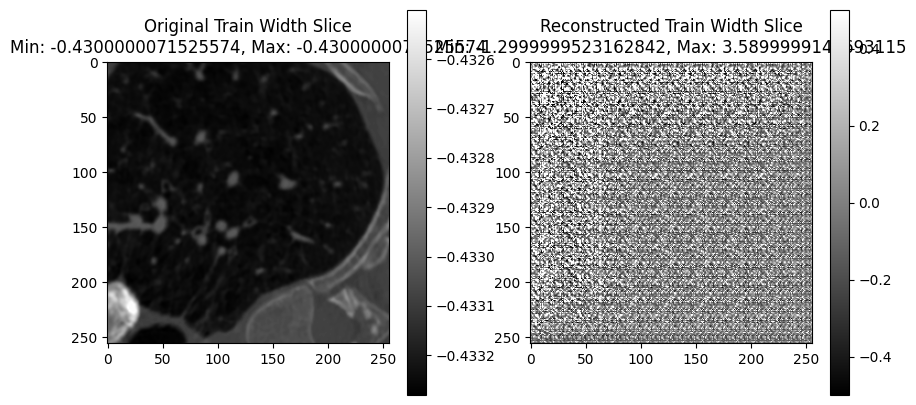

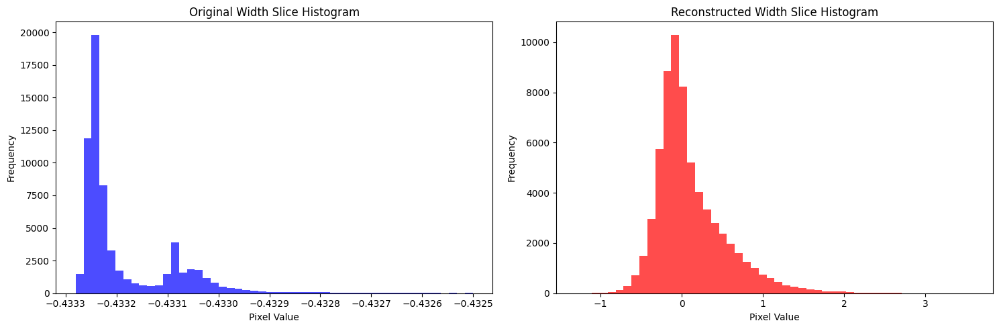

Validation: |          | 0/? [00:00<?, ?it/s]

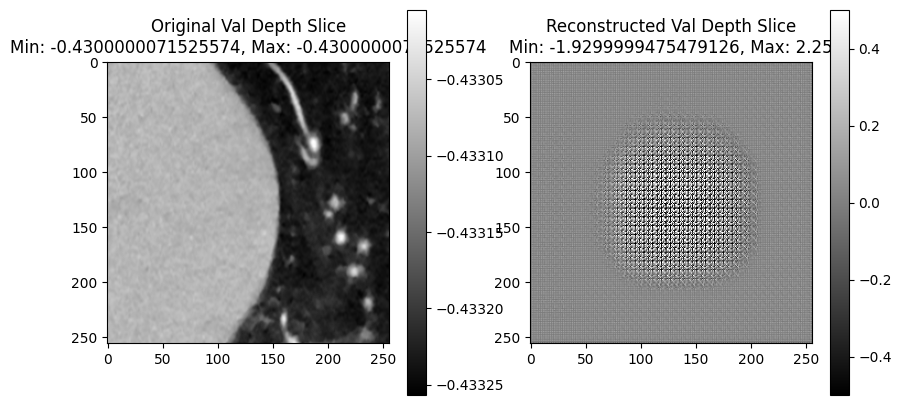

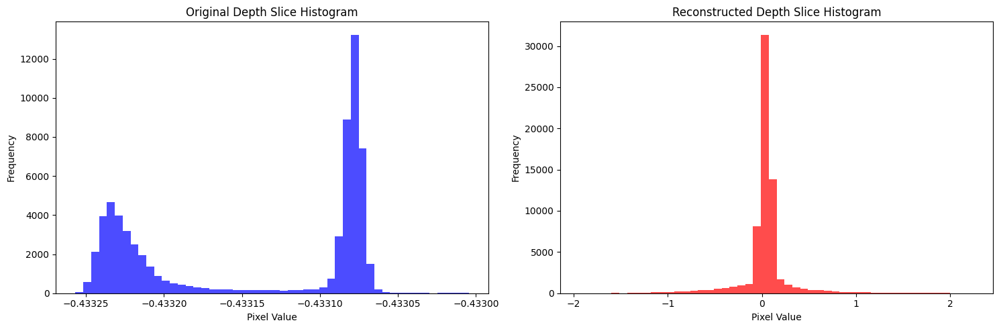

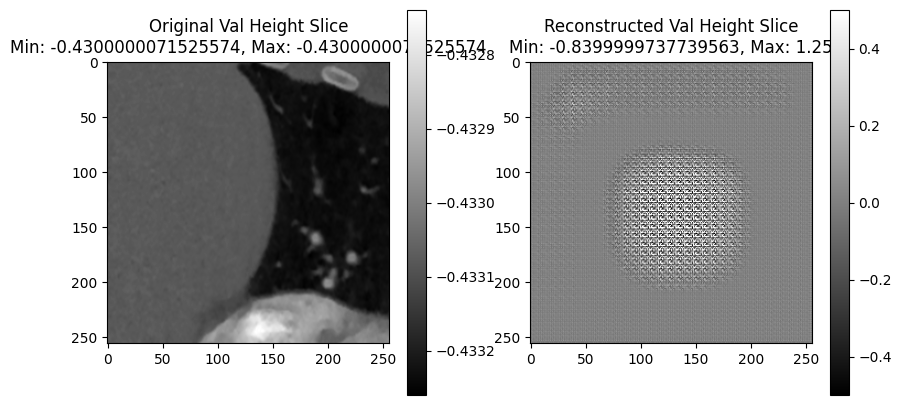

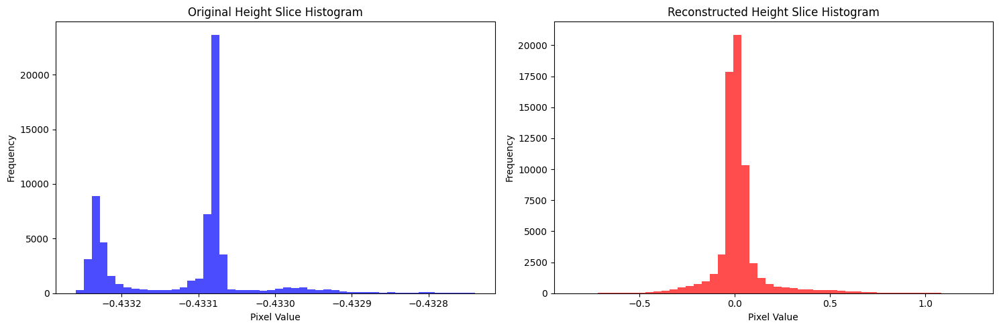

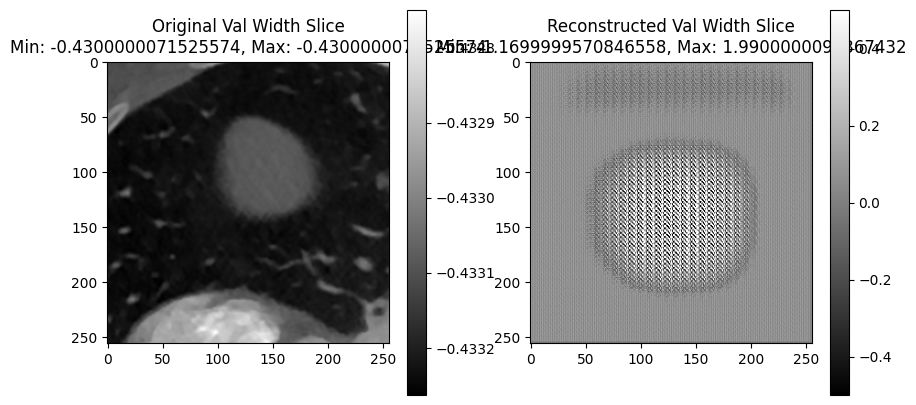

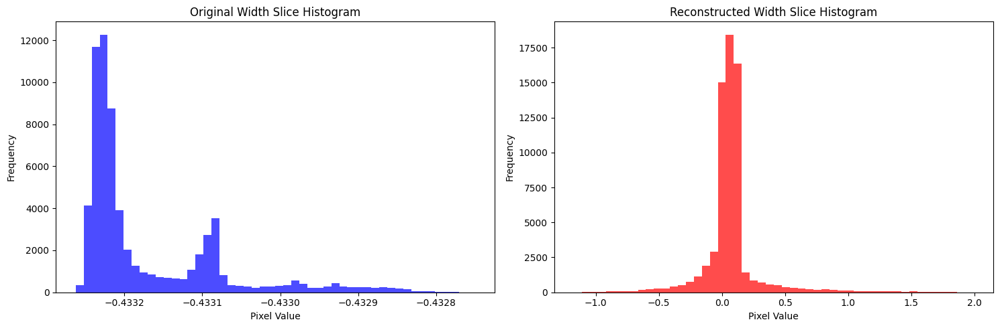

Time Spent 144.94
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 157.13
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 169.23
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 181.35
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 193.48
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 205.66
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 217.70
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 229.78
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 241.94
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 254.02
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 266.15
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 278.19
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 290.22
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 302.43
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 314.55
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 326.73
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 338.98
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 351.04
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 363.09
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 375.21
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 387.29
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 399.32
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 411.45
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 423.66
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 436.03
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 448.20
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 460.38
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 472.69
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 484.82
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 497.03
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 509.10
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 521.32
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 533.54
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 545.64
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 557.91
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 570.00
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 582.17
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 594.37
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 606.55
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 618.65
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 630.81
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 642.95
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 655.20
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 667.27
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 679.25
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 691.42
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 703.53
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 715.70
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 727.75
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 740.94
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 753.19
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 765.33
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 777.51
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 789.50
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 801.63
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 814.12
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 826.27
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 838.34
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 850.50
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 862.56
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 874.70
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 886.71
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 898.73
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 910.90
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 922.93
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 935.12
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 947.31
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 959.37
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 971.47
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 983.59
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 995.69
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1007.89
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1019.95
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1032.21
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1044.70
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1056.87
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1069.03
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1081.23
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1093.31
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1105.41
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1117.70
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1129.83
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1141.99
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1154.02
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1166.12
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1178.16
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1190.37
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1202.48
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1214.65
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1226.66
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1238.70
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1250.84
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1263.38
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1276.00
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1288.09
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1300.10
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1312.18
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1324.38
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1360.60
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1373.13
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1385.34
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1397.52
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1409.70
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1421.79
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1433.87
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1445.95
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1458.06
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1470.21
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1482.37
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1494.51
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1506.91
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1519.10
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1531.19
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1543.22
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1555.46
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1567.52
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1579.66
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1591.70
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1603.90
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1616.09
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1628.24
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1640.33
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1652.59
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1664.68
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1677.63
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1689.77
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1702.04
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1714.09
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1726.37
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1738.55
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1750.73
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1762.97
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1775.06
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1787.31
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1799.55
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1811.70
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1823.80
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1836.12
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1848.29
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1860.37
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1872.44
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1884.78
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1896.81
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1908.97
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1921.11
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1933.19
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1945.32
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1957.37
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1969.62
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1982.30
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1994.44
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2006.55
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2018.63
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2030.71
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2042.99
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2055.21
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2067.47
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2079.60
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2091.81
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2103.90
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2116.16
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2128.36
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2140.73
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2152.98
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2165.19
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2177.23
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2189.50
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2201.67
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2213.80
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2225.99
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2238.24
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2250.41
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2262.46
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2274.71
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2287.50
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2299.64
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2311.70
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2323.83
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2336.04
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2348.12
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2360.24
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2372.36
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2384.53
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2396.73
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2408.91
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2421.02
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2433.07
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2445.04
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2457.48
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2469.63
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2481.84
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2493.87
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2505.98
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2518.09
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2530.09
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2542.22
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2554.28
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2566.52
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2578.69
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2591.14
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2604.13
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2617.61
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2630.10
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2642.16
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2654.15
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2666.56
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2678.61
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2690.68
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2702.69
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2714.80
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2726.95
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2739.12
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2751.34
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2764.17
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2776.79
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2788.89
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2800.98
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2813.14
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2825.25
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2837.65
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2849.65
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2861.66
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2873.65
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2885.76
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2898.36
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2910.58
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2922.76
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2934.89
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2947.00
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2959.30
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2971.46
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2983.61
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2995.68
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3008.24
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3020.40
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3032.70
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3044.77
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3057.06
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3069.17
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3081.27
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3093.49
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3105.59
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3117.60
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3129.57
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3141.67
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3153.86
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3165.96
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3177.95
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3190.01
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3202.50
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3214.89
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3227.12
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3239.33
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3251.50
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3263.70
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3275.81
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3288.09
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3300.30
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3312.36
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3324.67
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3336.83
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3348.97
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3361.23
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3373.36
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3385.55
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3397.66
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3409.86
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3421.99
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3434.30
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3446.50
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3458.83
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3470.88
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3483.15
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3495.68
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3508.18
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3520.29
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3532.51
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3544.63
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3557.93
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3570.09
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3582.27
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3594.56
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3606.72
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3618.86
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3631.15
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3643.34
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3655.59
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3667.72
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3679.88
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3692.01
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3704.07
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3716.08
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3728.03
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3740.15
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3752.50
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3764.65
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3776.70
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3789.20
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3801.43
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3814.20
Epoch: 300


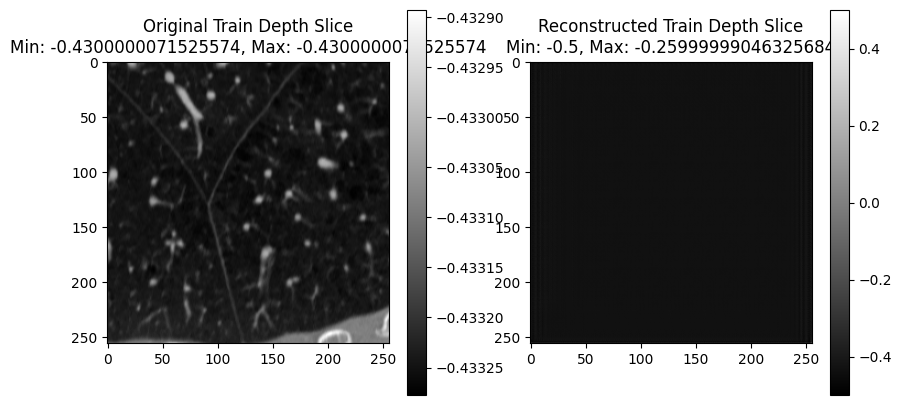

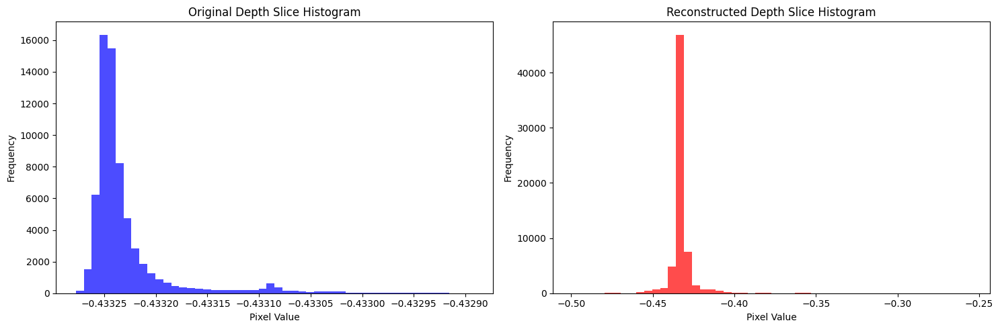

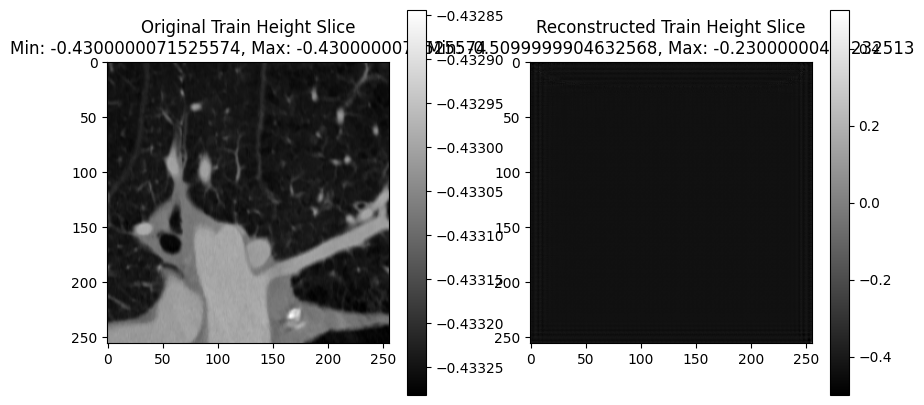

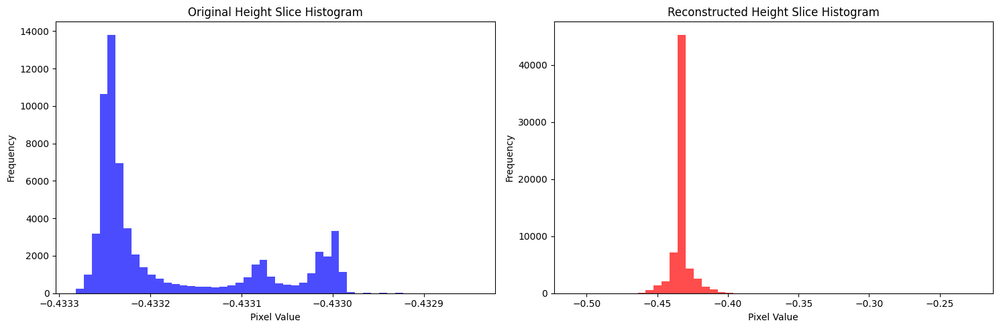

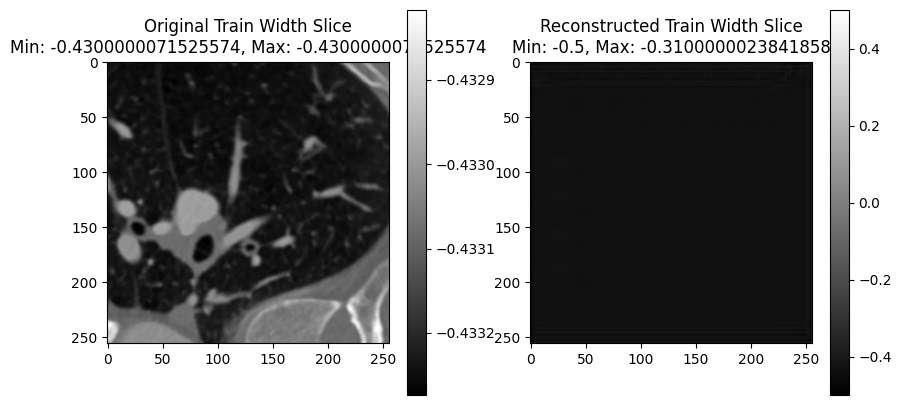

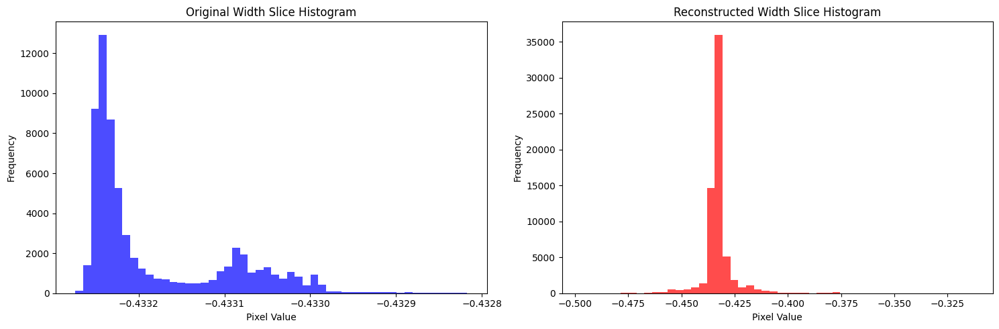

Validation: |          | 0/? [00:00<?, ?it/s]

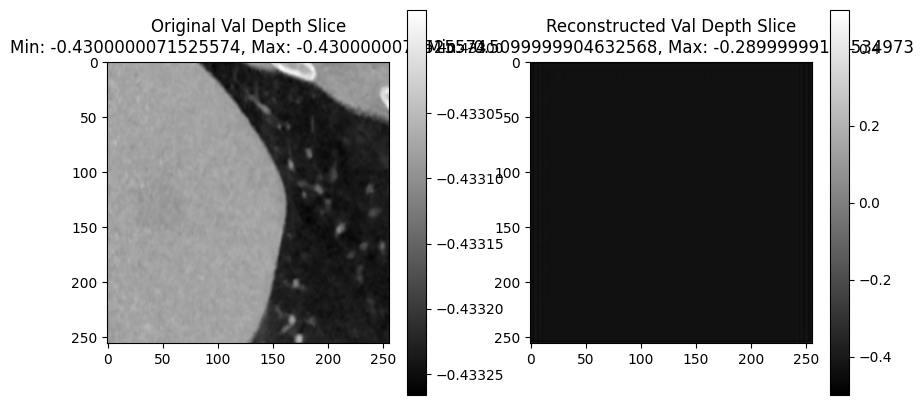

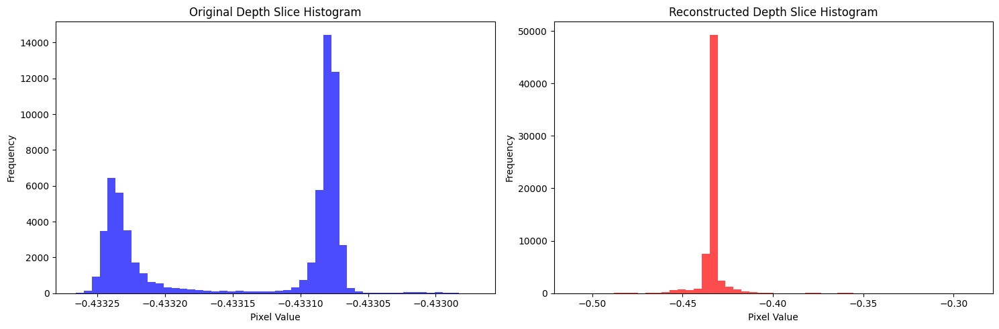

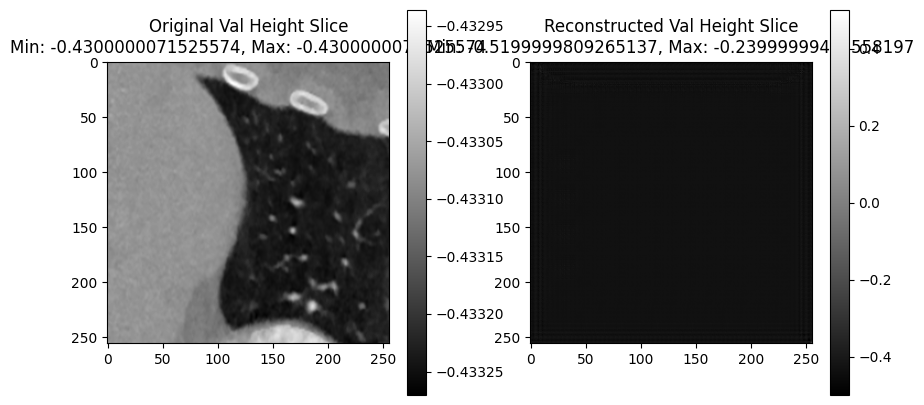

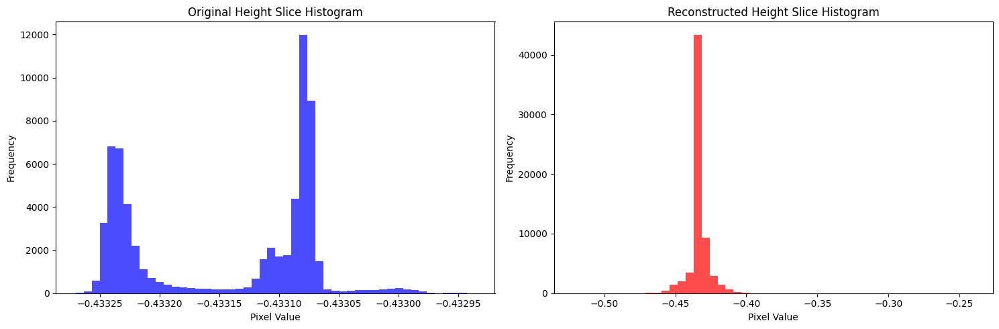

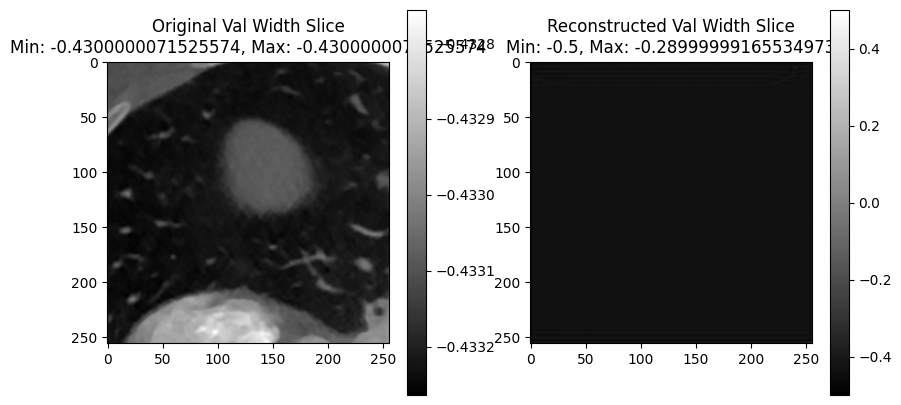

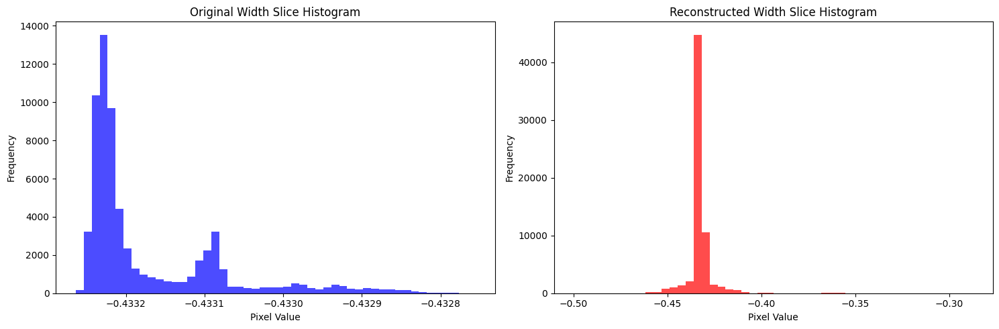

Time Spent 3834.31
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3846.31
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3858.51
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3870.86
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3883.05
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3895.27
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3907.48
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3919.72
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3931.79
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3943.87
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3956.12
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3968.26
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3980.35
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3993.30
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4005.36
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4017.37
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4029.46
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4041.46
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4054.19
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4066.30
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4078.45
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4090.59
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4102.62
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4114.67
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4127.30
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4140.25
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4153.43
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4165.56
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4177.88
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4189.84
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4201.95
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4213.99
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4226.26
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4238.36
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4250.37
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4262.40
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4274.61
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4286.77
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4298.80
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4310.89
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4322.98
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4335.33
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4347.54
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4359.74
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4371.90
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4383.99
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4396.13
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4408.52
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4420.70
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4433.39
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4445.51
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4457.59
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4470.47
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4482.78
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4494.88
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4506.99
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4519.34
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4531.79
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4543.98
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4556.04
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4568.40
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4580.59
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4592.80
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4604.95
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4616.97
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4629.11
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4641.27
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4653.35
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4665.58
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4677.67
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4689.85
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4701.94
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4714.11
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4726.29
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4738.71
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4750.79
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4762.86
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4774.91
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4786.81
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4798.91
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4810.96
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4822.99
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4835.28
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4847.40
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4859.47
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4871.68
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4883.68
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4895.68
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4907.74
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4919.89
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4932.03
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4944.23
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4956.34
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4968.37
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4980.39
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4992.38
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5004.42
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5016.55
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5028.61
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5041.05
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5053.96
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5066.00
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5078.07
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5090.45
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5102.47
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5114.88
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5126.99
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5139.20
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5151.41
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5163.65
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5175.67
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5187.74
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5199.92
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5212.14
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5224.39
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5236.69
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5248.81
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5261.61
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5273.88
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5286.29
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5298.37
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5310.68
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5322.78
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5335.03
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5347.56
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5359.72
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5371.99
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5384.07
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5396.24
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5408.27
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5420.40
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5432.68
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5445.11
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5457.16
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5469.28
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5481.35
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5493.43
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5505.61
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5517.73
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5529.81
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5541.87
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5554.04
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5566.47
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5578.51
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5590.79
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5602.88
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5614.90
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5626.99
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5639.51
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5651.99
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5664.14
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5676.21
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5688.25
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5700.27
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5712.29
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5724.56
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5736.56
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5748.62
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5761.14
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5773.30
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5785.47
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5797.59
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5809.69
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5821.86
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5833.87
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5846.17
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5858.37
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5870.35
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5882.41
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5894.54
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5906.65
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5918.78
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5930.87
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5943.01
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5955.70
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5967.71
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5979.97
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5992.05
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6004.21
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6016.37
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6028.44
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6040.74
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6052.93
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6065.14
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6077.40
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6089.57
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6101.91
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6114.04
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6126.25
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6138.29
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6150.44
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6162.64
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6174.87
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6187.28
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6199.48
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6211.60
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6223.70
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6235.81
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6248.07
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6260.72
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6272.83
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6285.06
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6297.19
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6309.29
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6321.39
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6333.70
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6346.04
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6358.25
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6370.36
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6382.53
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6394.71
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6406.95
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6419.03
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6431.16
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6443.25
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6455.52
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6467.79
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6479.98
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6492.07
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6504.22
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6516.50
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6528.69
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6541.02
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6553.24
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6565.91
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6578.08
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6590.33
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6602.49
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6614.61
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6626.77
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6639.04
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6651.16
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6663.36
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6675.52
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6687.79
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6699.99
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6712.43
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6724.68
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6736.74
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6748.81
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6760.82
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6773.04
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6785.34
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6797.62
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6809.86
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6821.99
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6834.19
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6846.39
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6858.80
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6871.38
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6883.48
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6895.60
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6907.76
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6919.91
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6932.03
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6944.19
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6956.35
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6968.48
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6980.52
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6992.51
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7004.71
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7016.95
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7028.98
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7041.07
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7053.24
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7065.47
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7077.48
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7089.94
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7101.99
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7114.04
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7126.19
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7138.39
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7150.55
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7162.71
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7175.38
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7187.51
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7199.99
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7212.33
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7224.42
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7236.66
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7248.75
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7260.78
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7272.97
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7285.29
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7297.50
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7309.68
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7321.80
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7334.05
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7346.16
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7358.33
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7370.50
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7382.64
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7394.73
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7406.94
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7419.18
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7432.69
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7444.82
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7457.19
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7469.35
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7482.01
Epoch: 600


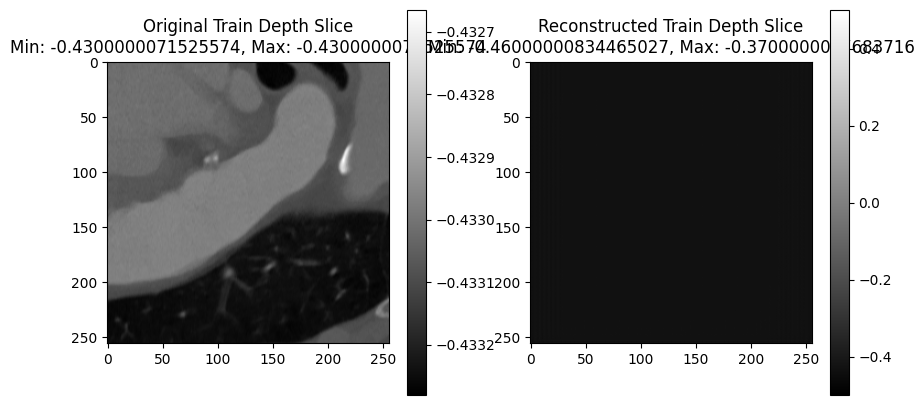

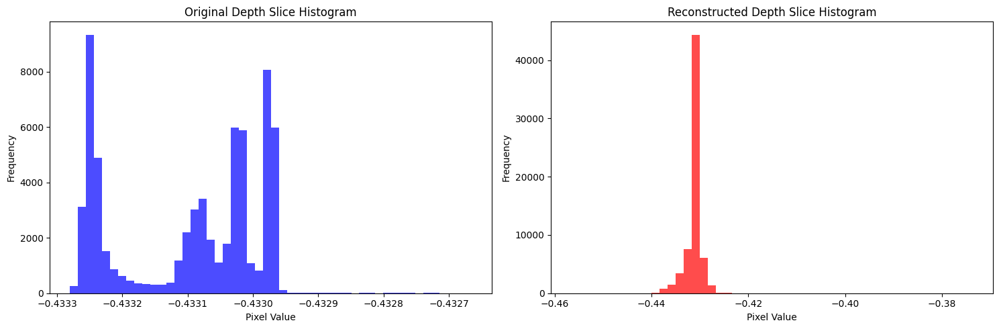

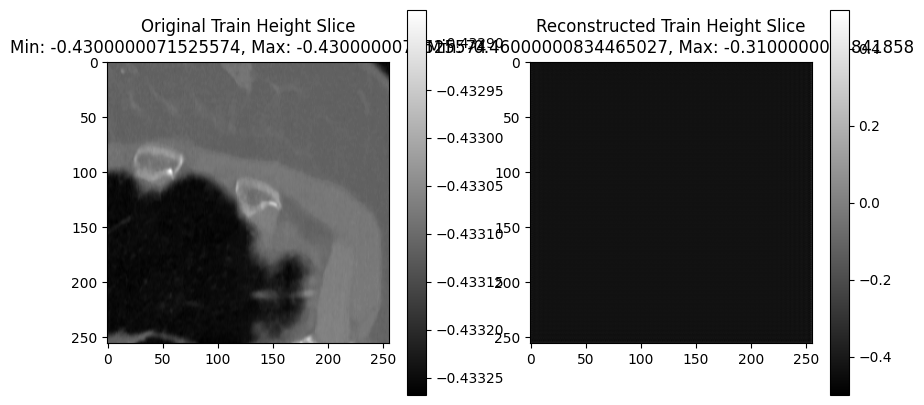

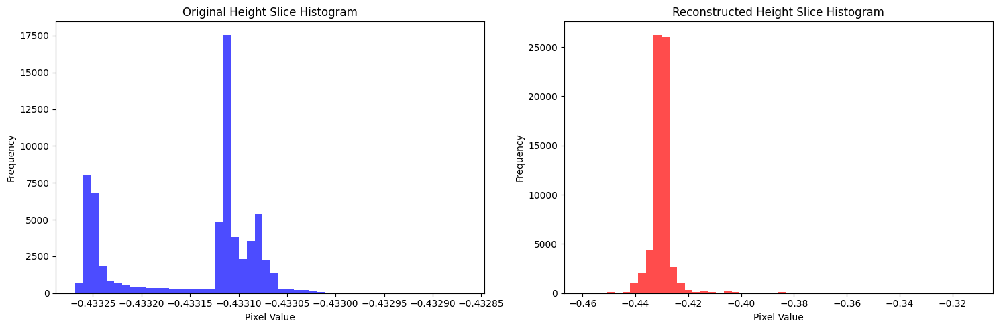

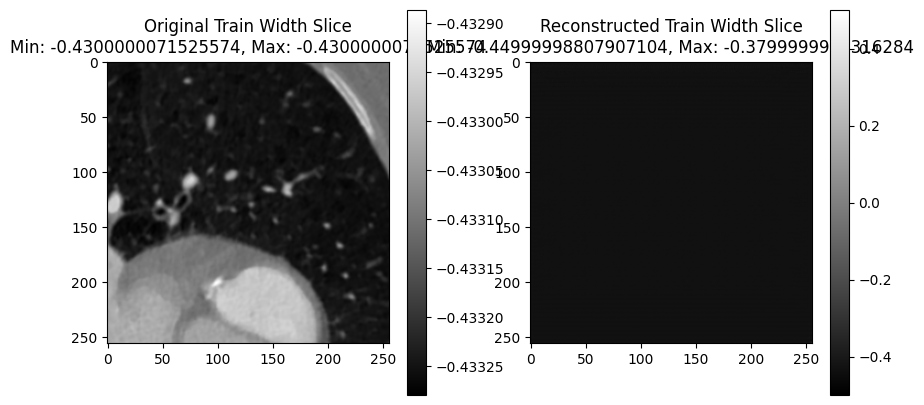

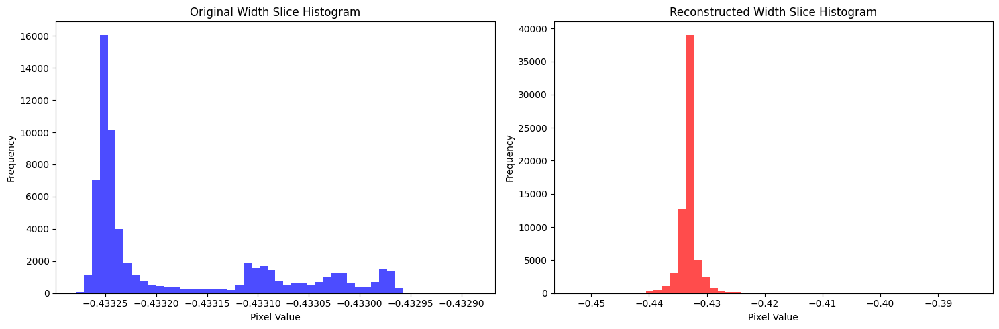

Validation: |          | 0/? [00:00<?, ?it/s]

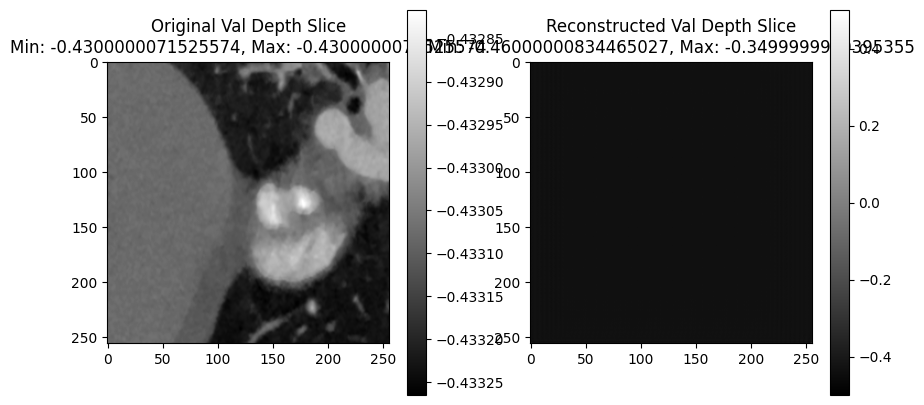

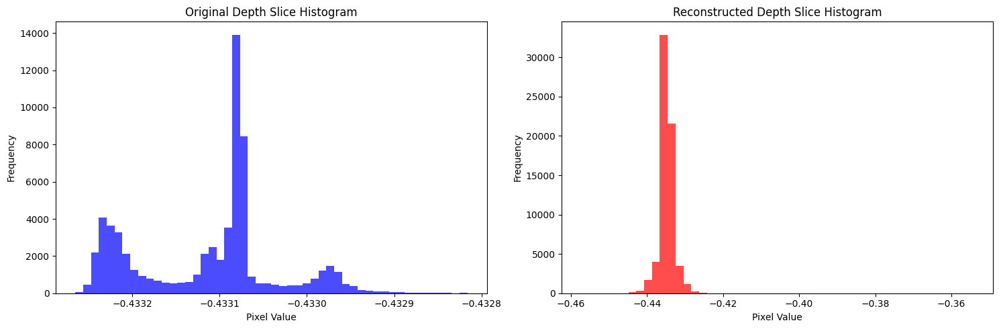

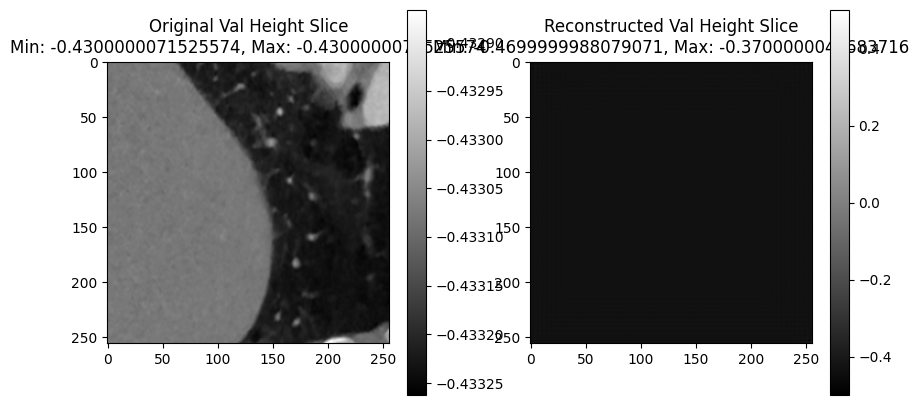

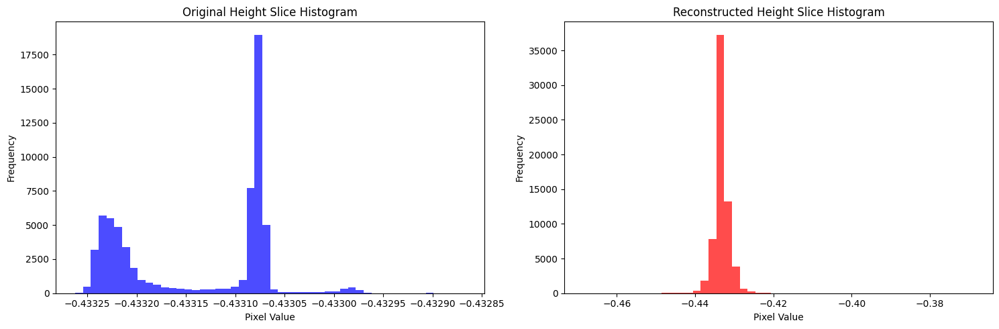

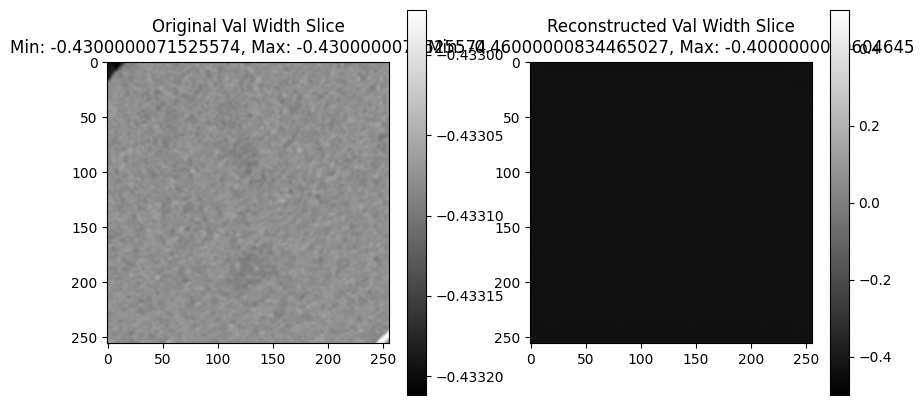

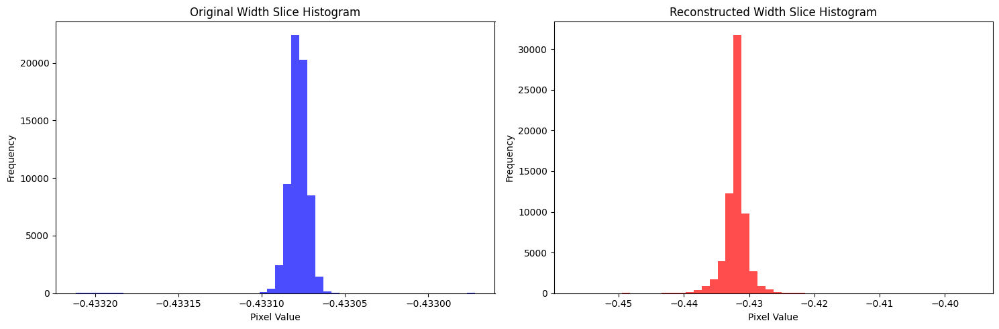

Time Spent 7502.96
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7515.07
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7527.57
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7539.69
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7551.84
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7564.14
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7576.34
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7588.48
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7600.98
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7613.22
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7625.38
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7637.48
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7649.59
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7661.77
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7673.89
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7686.20
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7698.29
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7710.45
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7722.49
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7734.75
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7746.82
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7759.01
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7771.15
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7783.35
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7795.91
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7807.99
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7820.13
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7832.38
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7844.44
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7856.45
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7868.51
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7880.62
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7892.88
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7905.38
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7917.42
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7929.65
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7941.82
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7953.89
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7966.10
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7978.20
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7990.29
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8002.39
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8014.43
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8026.67
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8038.79
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8050.89
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8063.02
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8075.11
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8087.18
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8099.78
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8111.90
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8123.96
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8136.33
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8148.52
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8160.75
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8172.99
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8185.18
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8197.24
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8209.59
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8222.14
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8234.34
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8246.48
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8258.62
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8270.78
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8283.23
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8295.39
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8307.51
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8319.72
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8331.85
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8344.10
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8356.25
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8368.39
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8380.70
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8392.88
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8405.49
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8417.66
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8429.82
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8442.02
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8454.36
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8466.48
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8478.60
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8490.68
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8502.79
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8514.89
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8526.94
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8539.12
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8551.31
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8563.44
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8575.55
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8587.67
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8599.90
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8612.25
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8624.38
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8636.56
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8648.57
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8660.68
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8672.65
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8684.83
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8696.79
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8709.28
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8721.27
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8733.29
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8745.54
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8757.69
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8769.78
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8781.89
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8793.91
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8806.21
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8818.75
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8830.91
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8843.07
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8855.18
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8867.25
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8879.37
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8891.51
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8903.60
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8915.63
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8927.67
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8939.83
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8951.96
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8964.15
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8976.31
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8988.47
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9000.52
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9013.10
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9025.29
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9037.47
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9049.64
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9061.66
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9073.84
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9086.79
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9098.89
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9111.16
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9123.24
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9135.39
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9147.62
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9159.88
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9172.10
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9184.35
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9196.50
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9208.61
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9220.86
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9233.20
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9245.46
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9257.61
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9269.80
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9282.11
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9294.33
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9306.45
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9318.98
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9330.97
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9343.05
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9355.29
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9367.32
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9379.47
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9391.68
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9403.77
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9415.83
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9427.93
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9440.10
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9452.26
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9464.60
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9477.00
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9489.29
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9501.40
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9513.60
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9525.65
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9537.78
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9550.14
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9562.43
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9574.70
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9586.99
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9599.21
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9611.37
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9624.05
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9636.25
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9648.34
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9660.49
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9672.71
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9684.96
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9697.10
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9709.16
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9721.27
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9733.58
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9745.80
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9757.94
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9770.29
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9782.41
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9794.54
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9806.73
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9818.97
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9831.15
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9843.30
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9855.40
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9867.56
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9879.77
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9891.84
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9904.07
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9917.40
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9930.00
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9943.00
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9954.97
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9967.16
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9979.43
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9991.53
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10003.69
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10015.80
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10028.00
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10040.11
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10052.14
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10064.36
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10076.51
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10088.62
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10100.80
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10112.99
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10124.95
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10137.06
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10149.11
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10161.21
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10173.32
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10185.26
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10197.39
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10209.62
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10221.80
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10234.22
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10246.31
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10258.52
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10270.61
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10282.80
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10294.88
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10307.01
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10319.17
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10331.15
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10343.19
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10355.28
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10367.34
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10379.55
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10391.67
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10403.93
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10416.05
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10428.35
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10440.76
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10452.82
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10464.87
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10476.80
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10488.87
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10500.98
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10513.20
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10525.27
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10537.81
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10549.86
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10561.97
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10574.13
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10586.37
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10598.26
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10610.88
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10622.97
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10635.12
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10647.21
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10659.59
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10671.64
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10683.78
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10696.01
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10708.16
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10720.32
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10732.41
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10744.49
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10756.60
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10768.65
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10780.75
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10792.89
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10804.97
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10817.08
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10829.13
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10841.62
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10853.76
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10865.91
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10878.17
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10890.19
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10902.42
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10914.55
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10926.62
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10938.89
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10951.00
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10963.06
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10975.09
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10987.33
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10999.47
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11011.47
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11023.55
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11035.58
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11047.75
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11059.87
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11071.93
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11084.00
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11095.99
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11108.09
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11120.44
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11132.73
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11145.31
Epoch: 900


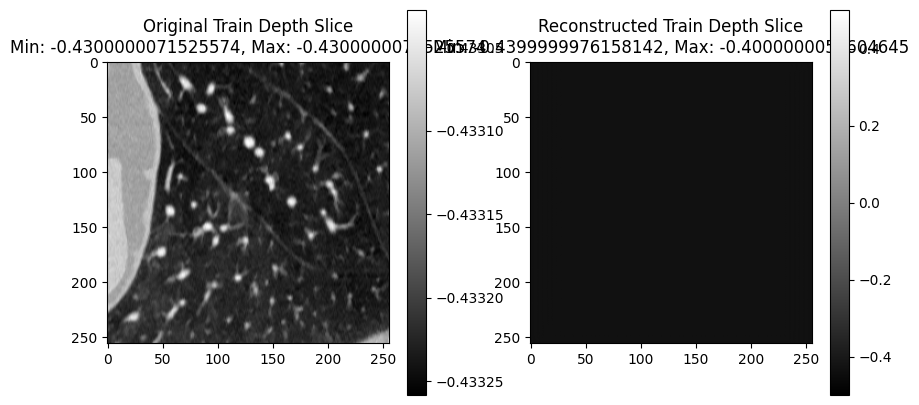

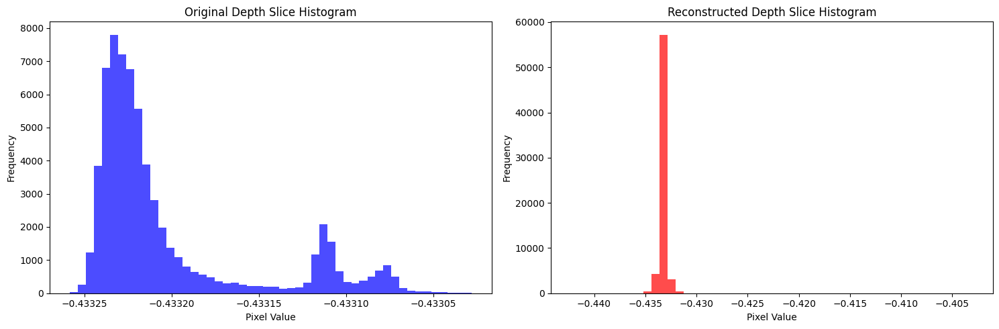

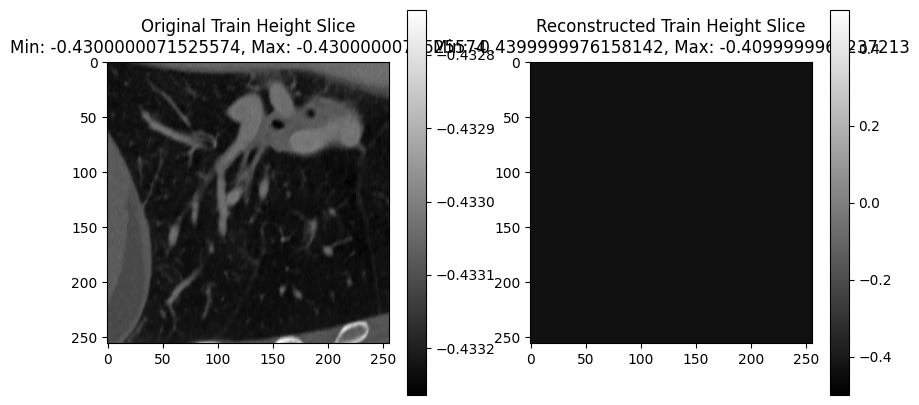

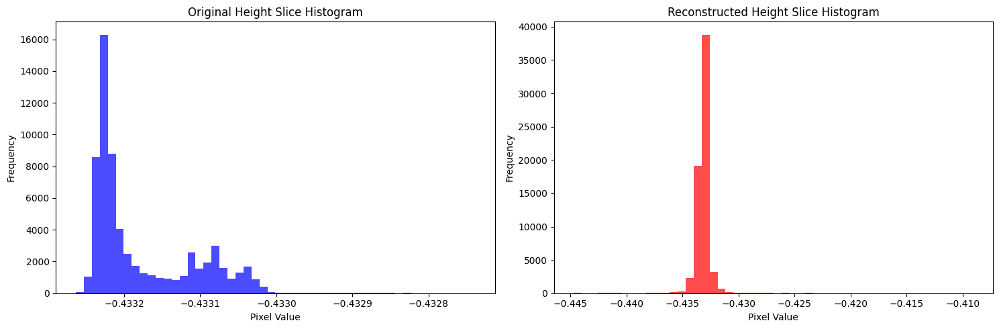

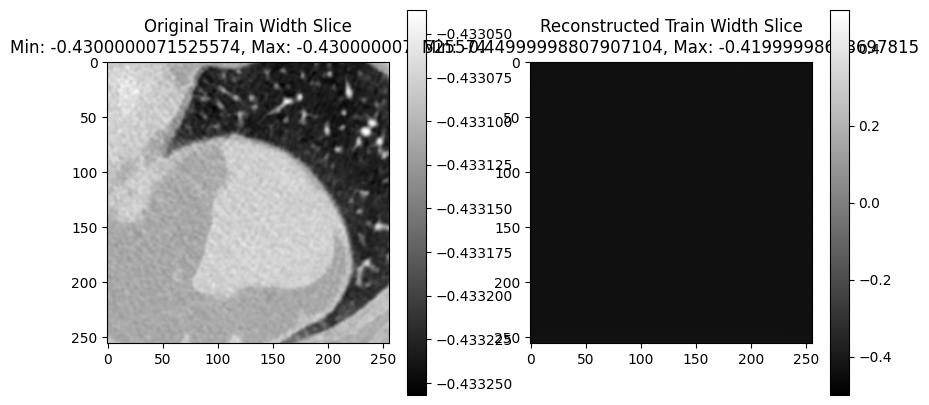

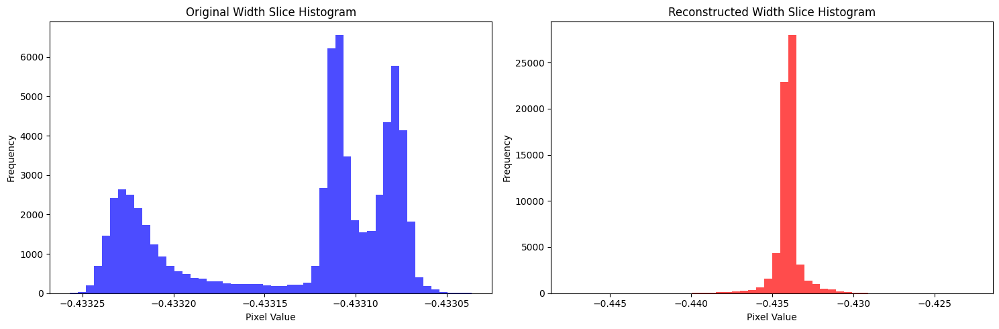

Validation: |          | 0/? [00:00<?, ?it/s]

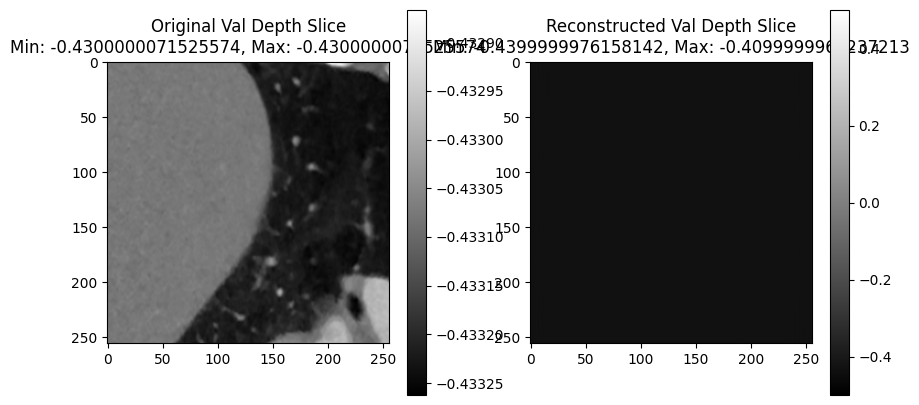

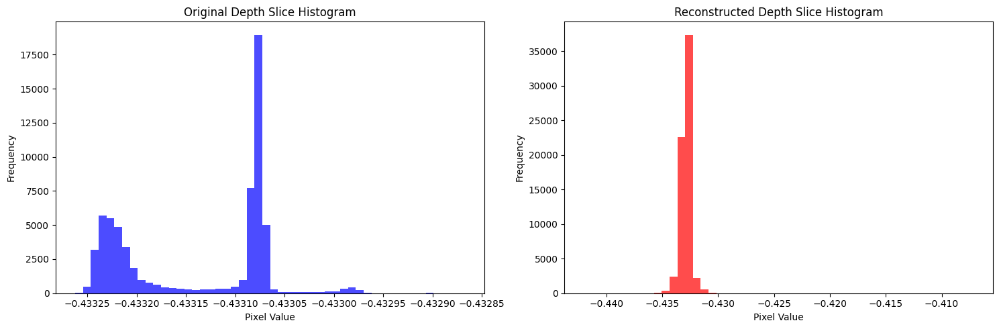

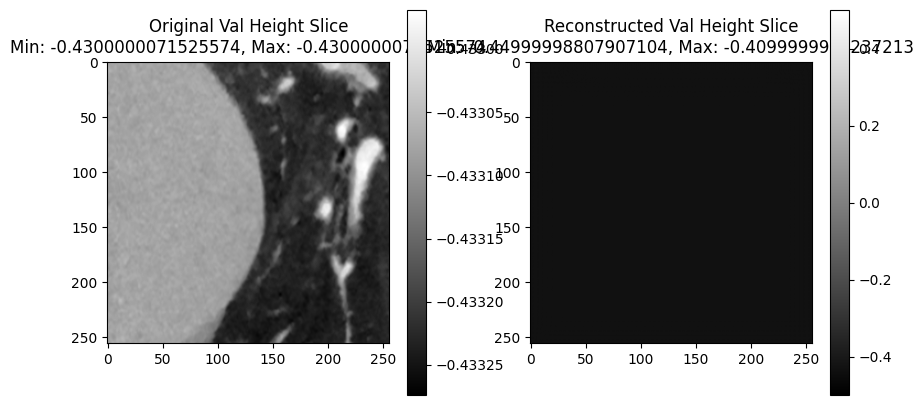

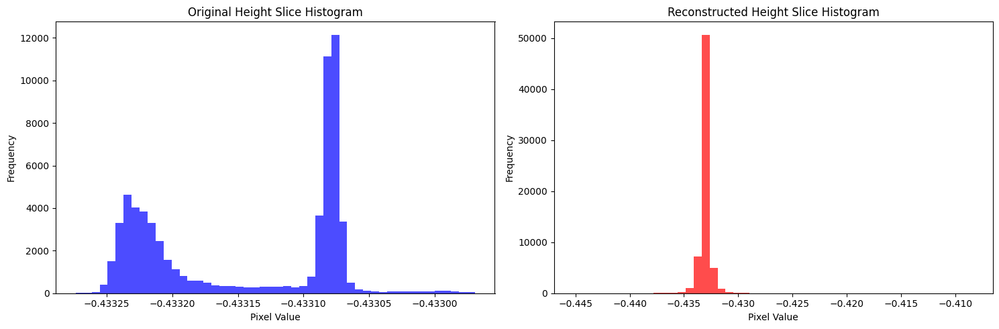

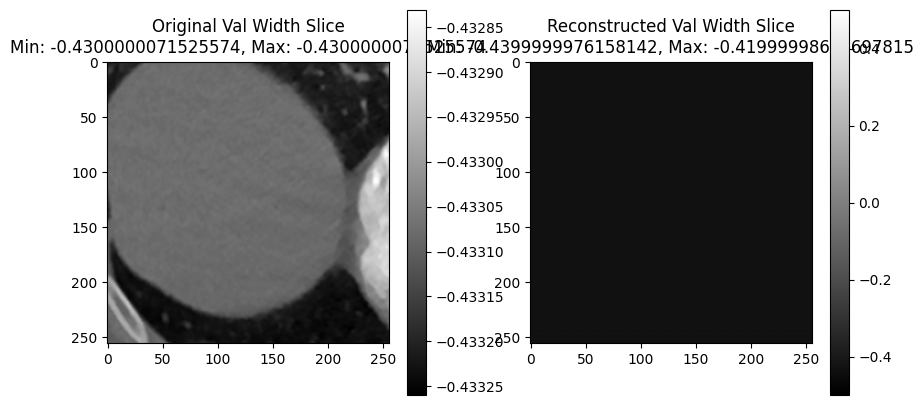

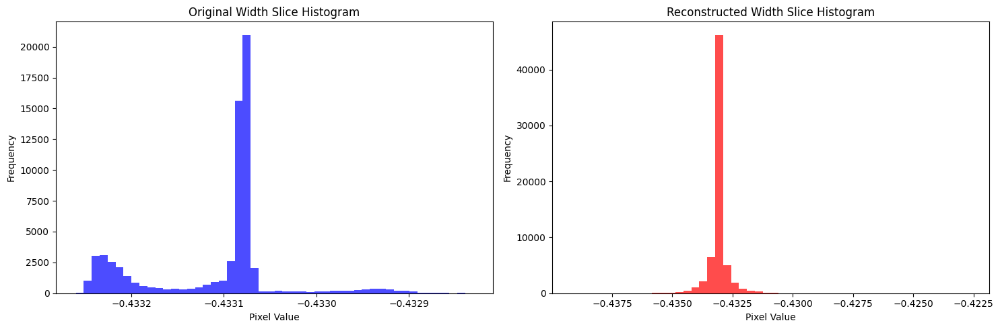

Time Spent 11164.88
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11177.19
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11189.41
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11201.48
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11213.67
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11225.93
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11238.10
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11250.77
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11263.07
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11275.27
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11287.38
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11299.66
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11311.91
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11324.66
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11336.86
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11349.00
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11361.29
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11373.43
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11385.68
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11398.05
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11410.19
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11422.39
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11434.58
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11446.71
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11459.40
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11471.81
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11483.99
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11496.23
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11508.46
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11520.63
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11532.84
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11545.09
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11557.14
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11569.72
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11582.02
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11594.23
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11606.67
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11618.66
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11630.83
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11643.06
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11655.32
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11667.52
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11679.72
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11692.01
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11704.39
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11716.58
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11729.42
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11741.66
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11753.91
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11766.46
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11778.61
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11790.81
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11803.18
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11815.38
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11827.63
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11839.79
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11852.12
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11864.40
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11876.48
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11888.58
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11900.84
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11913.05
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11925.22
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11937.20
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11949.47
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11961.67
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11973.98
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11986.11
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11998.39
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12010.58
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12022.70
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12034.88
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12047.09
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12059.31
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12075.57
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12087.77
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12099.94
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12112.20
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12124.37
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12136.46
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12148.53
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12160.57
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12172.76
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12185.24
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12197.39
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12209.50
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12221.58
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12233.56
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12245.76
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12257.82
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12270.02
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12282.11
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12294.19
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12306.37
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12318.49
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12330.64
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12342.75
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12354.96
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12367.27
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12379.77
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12392.90
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12404.99
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12417.20
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12429.40
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12441.69
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12453.89
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12466.06
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12478.26
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12490.49
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12502.66
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12514.91
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12527.08
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12539.28
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12551.61
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12563.66
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12575.85
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12587.97
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12599.92
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12611.97
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12624.55
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12636.62
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12648.81
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12660.94
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12673.06
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12685.73
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12697.89
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12710.16
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12722.34
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12734.50
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12746.75
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12758.87
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12771.19
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12783.42
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12795.80
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12808.23
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12820.50
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12832.71
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12844.94
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12857.09
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12869.34
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12881.36
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12893.52
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12905.62
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12917.73
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12929.84
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12941.97
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12954.19
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12966.29
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12978.48
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12991.09
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13003.32
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13015.32
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13027.56
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13039.64
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13051.69
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13063.90
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13076.10
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13088.18
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13100.71
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13112.98
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13125.18
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13137.71
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13150.05
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13162.12
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13174.24
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13186.42
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13198.66
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13210.98
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13223.19
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13235.29
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13247.35
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13259.43
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13271.55
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13283.66
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13296.07
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13307.97
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13320.08
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13332.18
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13344.35
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13356.28
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13368.40
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13380.59
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13392.61
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13404.68
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13416.91
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13429.18
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13441.40
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13453.46
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13465.77
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13477.94
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13490.09
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13502.22
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13514.37
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13526.66
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13538.92
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13551.20
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13563.30
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13575.52
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13587.70
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13600.28
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13612.40
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13624.53
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13636.72
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13648.91
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13661.20
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13673.39
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13685.73
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13697.88
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13710.09
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13722.38
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13734.68
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13746.97
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13759.12
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13771.25
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13783.52
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13795.69
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13808.14
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13820.42
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13832.68
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13844.90
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13857.11
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13869.36
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13881.53
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13893.79
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13906.43
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13918.59
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13930.72
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13942.82
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13954.96
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13967.20
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13979.38
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13991.61
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14003.84
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14015.91
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14028.07
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14040.20
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14052.66
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14065.71
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14078.01
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14090.30
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14102.44
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14114.61
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14126.73
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14138.92
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14150.97
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14163.08
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14175.42
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14187.72
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14199.97
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14212.45
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14224.57
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14236.76
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14248.86
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14261.06
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14273.34
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14285.80
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14298.05
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14310.21
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14322.61
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14334.80
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14346.97
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14359.60
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14371.93
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14384.06
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14396.44
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14408.57
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14420.71
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14432.90
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14445.01
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14457.19
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14469.42
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14481.60
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14493.67
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14505.92
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14518.50
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14530.82
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14543.12
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14555.37
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14567.54
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14579.91
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14591.95
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14604.22
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14616.41
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14628.57
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14640.78
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14653.03
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14665.18
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14677.42
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14689.68
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14701.90
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14713.92
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14726.02
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14738.43
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14750.55
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14764.07
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14776.52
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14788.80
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14801.15
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14813.59
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14826.44
Epoch: 1200


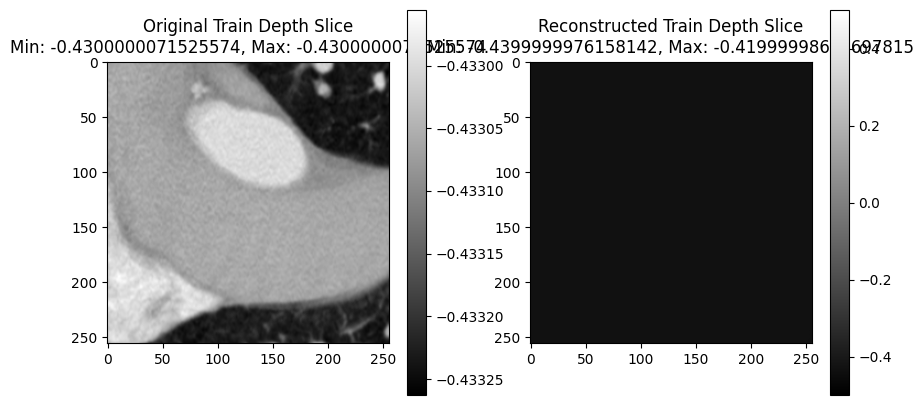

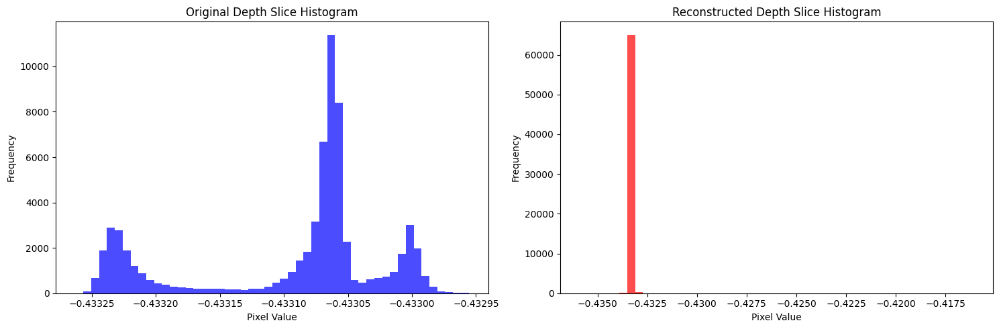

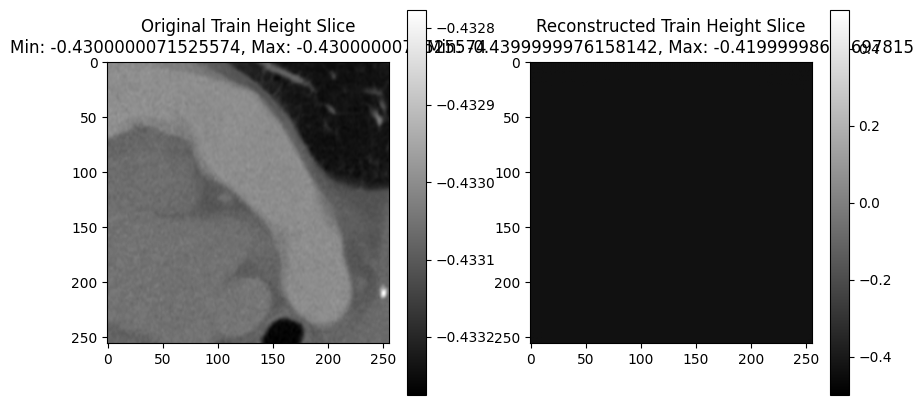

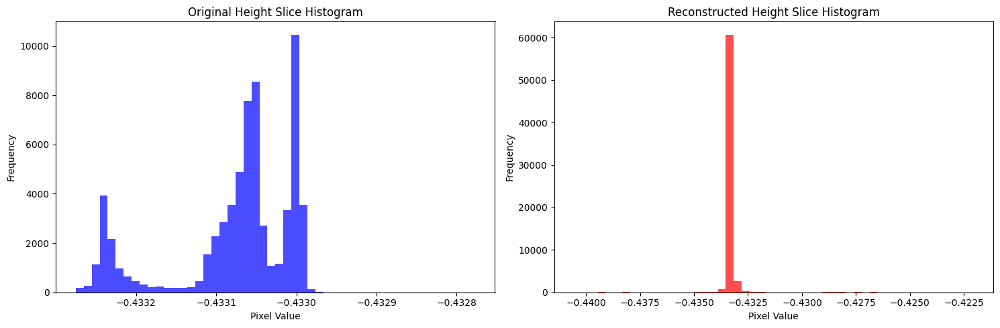

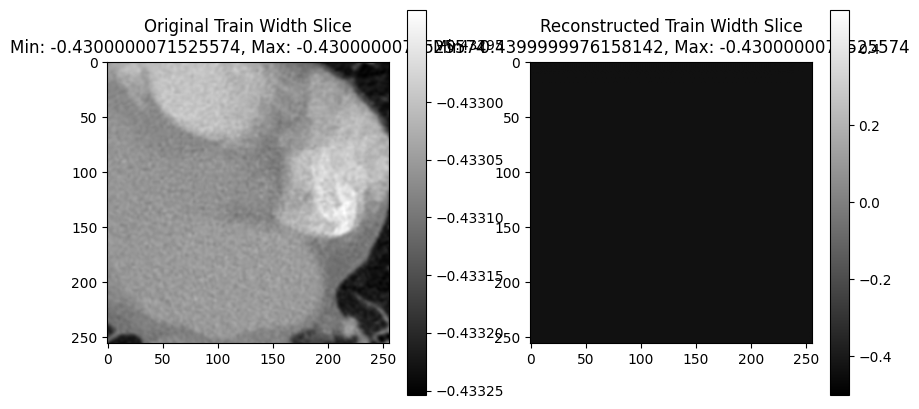

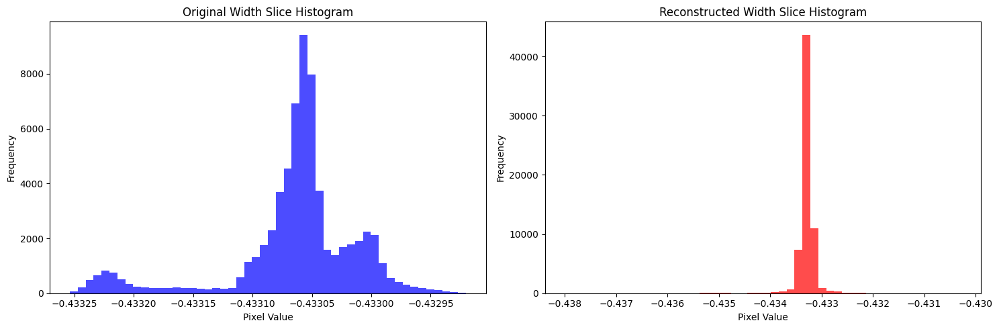

Validation: |          | 0/? [00:00<?, ?it/s]

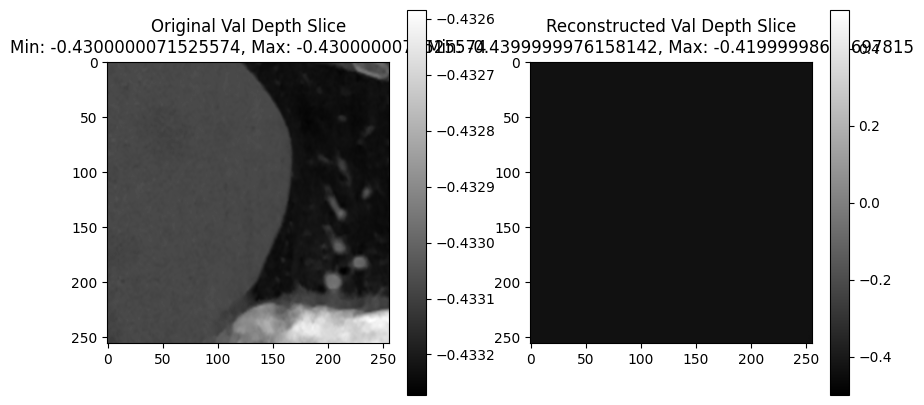

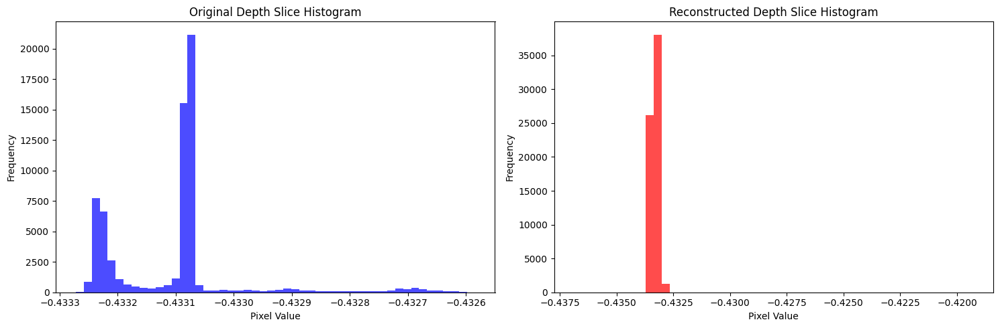

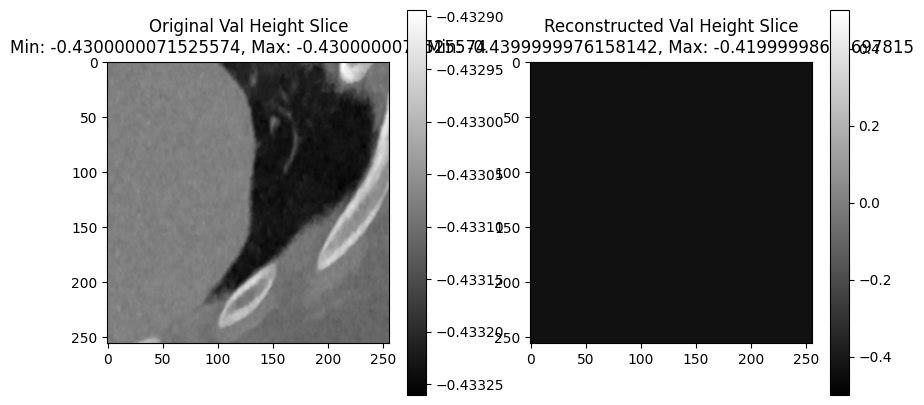

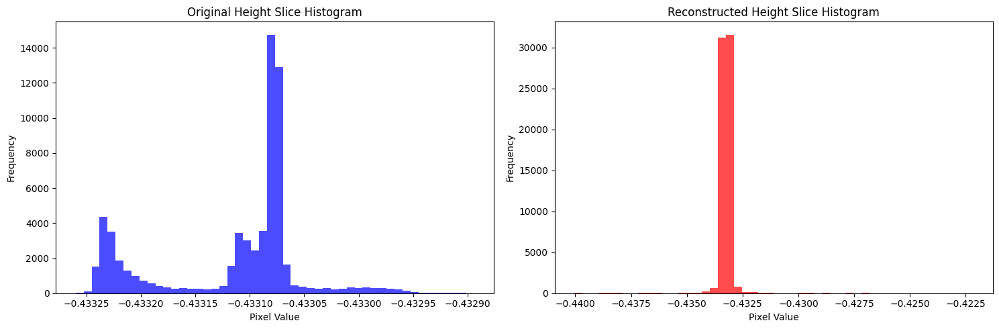

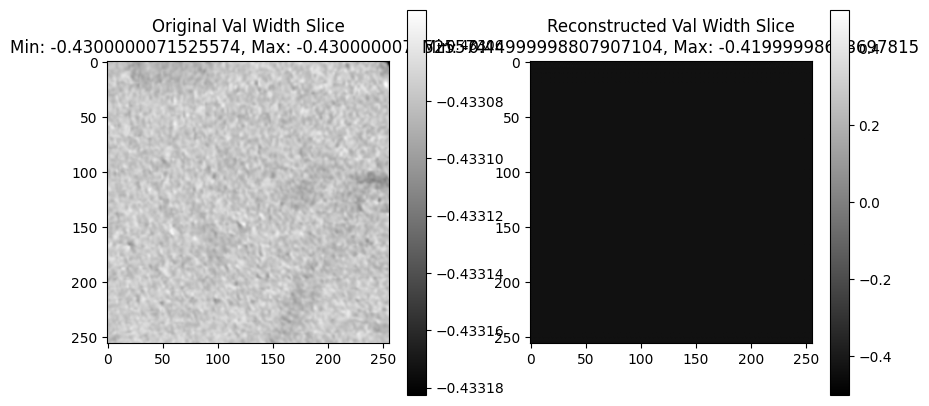

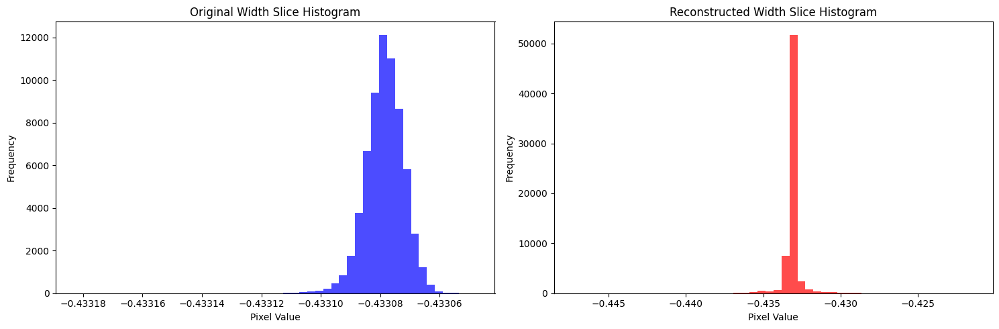

Time Spent 14848.38
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14860.39
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14873.20
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14886.46
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14900.40
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14912.51
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14924.58
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14936.66
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14948.79
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14960.96
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14973.30
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14986.84
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14999.12
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15012.36
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15025.56
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15038.07
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15059.57
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15087.43
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15122.85
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15135.90
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15150.14
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15162.49
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15174.80
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15187.20
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15200.46
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15212.62
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15224.79
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15237.24
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15249.50
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15261.74
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15274.00
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15286.24
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15298.63
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15310.99
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15323.36
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15335.65
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15347.73
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15360.18
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15373.12
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15385.39
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15397.70
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15411.81
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15425.94
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15438.92
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15454.01
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15466.67
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15481.84
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15496.56
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15512.54
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15527.14
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15540.53
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15554.39
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15568.63
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15583.50
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15602.78
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15619.22
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15633.72
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15646.15
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15664.20
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15678.77
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15693.00
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15708.83
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15725.84
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15746.56
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15769.78
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15783.89
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15796.39
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15809.59
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15822.06
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15834.91
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15859.22
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15873.35
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15889.51
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15905.03
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15925.40
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15942.00
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15979.80
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16053.14
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16065.35
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16085.10
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16098.30
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16187.34
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16205.85
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16219.99
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16271.75
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16301.02
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16313.18
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16325.36
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16337.51
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16349.70
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16361.82
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16373.90
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16386.05
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16398.14
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16410.68
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16422.97
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16435.07
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16447.17
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16459.34
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16471.77
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16483.85
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16496.06
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16508.16
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16520.38
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16532.61
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16544.88
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16557.06
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16569.56
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16582.04
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16594.13
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16606.16
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16618.30
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16630.50
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16642.43
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16654.63
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16666.78
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16678.89
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16691.31
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16703.46
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16715.87
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16727.92
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16740.07
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16752.17
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16764.35
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16776.86
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16789.09
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16801.27
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16813.40
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16825.64
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16837.81
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16850.07
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16862.18
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16874.25
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16886.29
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16898.36
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16910.46
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16922.71
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16934.86
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16946.99
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16959.27
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16971.66
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16983.81
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16996.04
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17008.88
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17021.05
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17033.03
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17045.24
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17057.47
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17069.66
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17082.07
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17094.20
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17106.24
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17118.49
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17130.57
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17142.95
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17155.03
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17167.20
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17179.27
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17191.41
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17203.50
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17215.58
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17227.76
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17239.81
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17251.84
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17264.06
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17276.10
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17288.11
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17300.15
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17312.22
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17324.61
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17336.59
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17348.72
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17360.68
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17372.79
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17385.30
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17397.38
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17409.50
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17421.55
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17434.07
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17446.32
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17458.40
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17470.49
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17482.70
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17494.94
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17507.35
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17519.59
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17531.80
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17543.91
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17556.06
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17568.28
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17580.48
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17592.68
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17604.79
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17617.03
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17629.39
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17641.47
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17653.69
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17665.90
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17678.21
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17690.81
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17703.89
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17716.02
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17728.16
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17740.41
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17752.56
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17764.88
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17778.09
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17790.53
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17802.79
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17815.20
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17827.25
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17839.84
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17852.21
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17864.43
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17876.65
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17888.94
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17901.34
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17913.67
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17927.02
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17939.30
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17951.52
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17963.72
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17975.99
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17988.35
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18001.07
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18013.39
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18025.96
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18038.08
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18050.22
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18062.60
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18075.12
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18087.62
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18100.55
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18112.69
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18124.94
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18137.33
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18149.59
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18161.89
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18174.28
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18186.48
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18198.90
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18211.41
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18223.59
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18235.86
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18250.03
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18262.52
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18274.65
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18287.32
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18299.58
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18312.08
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18324.42
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18336.74
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18348.96
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18361.35
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18373.63
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18385.96
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18398.21
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18410.38
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18422.47
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18434.74
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18446.98
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18459.22
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18471.48
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18483.67
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18495.85
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18508.11
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18520.26
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18532.46
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18544.60
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18556.87
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18569.17
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18581.31
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18593.54
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18605.83
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18618.38
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18630.51
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18642.69
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18655.03
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18667.34
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18679.56
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18691.59
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18703.84
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18715.95
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18728.01
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18740.18
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18752.38
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18764.70
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18776.81
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18789.00
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18801.12
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18813.44
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18825.79
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18838.02
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18850.28
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18862.41
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18874.63
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18886.87
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18899.10
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18911.21
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18923.79
Epoch: 1500


`Trainer.fit` stopped: `max_epochs=1500` reached.


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1386133      

In [3]:
# Initialize model and start training
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')

In [4]:
'''
spatial_dims = 3
in_channels = 1
out_channels = 1
channels = (16, 32, 64, 128, 256)
strides = (2, 2, 2, 2, 2)

# Initialize the AutoEncoder model with the specified parameters
model = AutoEncoder(
    spatial_dims=spatial_dims,
    in_channels=in_channels,
    out_channels=out_channels,
    channels=channels,
    strides=strides)

# Load the state dictionary from the checkpoint file
model_path = "./aeSSIM.pth"
checkpoint = torch.load(model_path)

# Filter out unnecessary keys (e.g., metadata, optimizer states)
state_dict = {k.replace('autoencoder.', ''): v for k, v in checkpoint['state_dict'].items()}

# Load the state dictionary into the model
model.load_state_dict(state_dict)

# Set the model to evaluation mode
model.eval()
def generate_random_slices(model, device, num_samples=3):
    for _ in range(num_samples):
        # Generate random input tensor
        input_tensor = torch.randn(2, 1, 256, 256, 256).to(device)  # Assuming input size is (1, 1, 256, 256, 256)

        # Generate reconstruction
        with torch.no_grad():
            reconstruction = model(input_tensor)

        # Convert tensors to numpy arrays and move them to CPU
        input_slice = input_tensor.squeeze().detach().cpu().numpy()
        reconstruction_slice = reconstruction.squeeze().detach().cpu().numpy()

        # Randomly select a slice index
        slice_idx = np.random.randint(0, input_slice.shape[0])

        # Plot original and reconstructed slices
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(input_slice[slice_idx], cmap='gray')
        plt.title(f'Original Slice - Index {slice_idx}')

        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice[slice_idx], cmap='gray')
        plt.title(f'Reconstructed Slice - Index {slice_idx}')

        plt.show()

# Call the function to generate and visualize random slices
generate_random_slices(model, device)
'''

'\nspatial_dims = 3\nin_channels = 1\nout_channels = 1\nchannels = (16, 32, 64, 128, 256)\nstrides = (2, 2, 2, 2, 2)\n\n# Initialize the AutoEncoder model with the specified parameters\nmodel = AutoEncoder(\n    spatial_dims=spatial_dims,\n    in_channels=in_channels,\n    out_channels=out_channels,\n    channels=channels,\n    strides=strides)\n\n# Load the state dictionary from the checkpoint file\nmodel_path = "./aeSSIM.pth"\ncheckpoint = torch.load(model_path)\n\n# Filter out unnecessary keys (e.g., metadata, optimizer states)\nstate_dict = {k.replace(\'autoencoder.\', \'\'): v for k, v in checkpoint[\'state_dict\'].items()}\n\n# Load the state dictionary into the model\nmodel.load_state_dict(state_dict)\n\n# Set the model to evaluation mode\nmodel.eval()\ndef generate_random_slices(model, device, num_samples=3):\n    for _ in range(num_samples):\n        # Generate random input tensor\n        input_tensor = torch.randn(2, 1, 256, 256, 256).to(device)  # Assuming input size is (1,